In [15]:
using LinearAlgebra
using SparseArrays
using Plots
using Polynomials
using Statistics
using SymRCM

# Exercise 2.1

##### a)

In [2]:
function xy(x0::Float64,y0::Float64,L1::Float64,L2::Float64,noelms1::Int64,noelms2::Int64) :: Tuple{Vector{Float64},Vector{Float64}}
    VX = repeat(collect(LinRange(x0,x0+L1,noelms1+1)),inner=noelms2+1)
    VY = repeat(collect(LinRange(y0+L2,y0,noelms2+1)),noelms1+1)
    return VX,VY
end

VX,VY = xy(-2.5,-4.8,7.6,5.9,4,3)
display(VX)
display(VY)


20-element Vector{Float64}:
 -2.5
 -2.5
 -2.5
 -2.5
 -0.6000000000000001
 -0.6000000000000001
 -0.6000000000000001
 -0.6000000000000001
  1.2999999999999998
  1.2999999999999998
  1.2999999999999998
  1.2999999999999998
  3.1999999999999997
  3.1999999999999997
  3.1999999999999997
  3.1999999999999997
  5.1
  5.1
  5.1
  5.1

20-element Vector{Float64}:
  1.1000000000000005
 -0.8666666666666661
 -2.833333333333333
 -4.8
  1.1000000000000005
 -0.8666666666666661
 -2.833333333333333
 -4.8
  1.1000000000000005
 -0.8666666666666661
 -2.833333333333333
 -4.8
  1.1000000000000005
 -0.8666666666666661
 -2.833333333333333
 -4.8
  1.1000000000000005
 -0.8666666666666661
 -2.833333333333333
 -4.8

##### b)

In [3]:
#=
function conelmtab(noelms1::Int64,noelms2::Int64) :: Matrix{Int64}
    EToV = zeros((noelms1*noelms2*2,3))
    for i in 1:noelms1
        for j in 1:noelms2
            EToV[(j+(i-1)*noelms2)*2-1,:] = [j+i*(noelms2+1),j+(i-1)*(noelms2+1),j+i*(noelms2+1)+1]
            EToV[(j+(i-1)*noelms2)*2,:] = [j+(i-1)*(noelms2+1)+1,j+i*(noelms2+1)+1,j+(i-1)*(noelms2+1)]
        end
    end
    return EToV
end
=#


function conelmtab(noelms1::Int64, noelms2::Int64)::Matrix{Int64}
    k = [i for i in 1:(noelms1*(noelms2+1)) if i % (noelms2+1) != 0]

    return [
        k (2 + noelms2 .+ k) (1 + noelms2 .+ k);
        k (1 .+ k) (2 + noelms2 .+ k)
    ]
end


EToV = conelmtab(4,3)

24×3 Matrix{Int64}:
  1   6   5
  2   7   6
  3   8   7
  5  10   9
  6  11  10
  7  12  11
  9  14  13
 10  15  14
 11  16  15
 13  18  17
 14  19  18
 15  20  19
  1   2   6
  2   3   7
  3   4   8
  5   6  10
  6   7  11
  7   8  12
  9  10  14
 10  11  15
 11  12  16
 13  14  18
 14  15  19
 15  16  20

# Exercise 2.2

##### a)

In [4]:
function basfun(n::Int64,VX::Vector{Float64},VY::Vector{Float64},EToV::Matrix{Int64}) :: Tuple{Float64,Matrix{Float64}}
    idxs = EToV[n,:]
    #delta = (VX[idxs[2]]*VY[idxs[3]]-VY[idxs[2]]*VX[idxs[3]]-VX[idxs[1]]*VY[idxs[3]]+VY[idxs[1]]*VX[idxs[3]]+VX[idxs[1]]*VY[idxs[2]]-VY[idxs[1]]*VX[idxs[2]])/2
    abc = zeros((3,3))
    for i in 0:2
        j = (i+1)%3
        k = (i+2)%3
        abc[i+1,1] = VX[idxs[j+1]]*VY[idxs[k+1]] - VX[idxs[k+1]]*VY[idxs[j+1]]
        abc[i+1,2] = VY[idxs[j+1]] - VY[idxs[k+1]]
        abc[i+1,3] = VX[idxs[k+1]] - VX[idxs[j+1]]
    end
    delta = sum(abc[:,1])/2
    return delta,abc
end

delta,abc = basfun(4,VX,VY,EToV)
display(delta)
display(abc)

1.8683333333333332

3×3 Matrix{Float64}:
  2.55667  -1.96667   0.0
  2.09      0.0      -1.9
 -0.91      1.96667   1.9

##### b)

In [5]:
function outernormal(n::Int64,k::Int64,VX::Vector{Float64},VY::Vector{Float64},EToV::Matrix{Int64}) :: Vector{Float64}
    if k == 3
        idxs = EToV[n,[3 1]]
    else 
        idxs = EToV[n,k:k+1]
    end
    xs = VX[idxs]
    ys = VY[idxs]
    t = [xs[2]-xs[1],ys[2]-ys[1]]
    return -([t[2],-t[1]]/norm(t))
end

outernormal(9,2,VX,VY,EToV)


2-element Vector{Float64}:
 -1.0
  0.0

# Exercise 2.3

##### a)

25×25 SparseMatrixCSC{Float64, Int64} with 105 stored entries:
⎡⠻⣦⡈⠢⡀⠀⠀⠀⠀⠀⠀⠀⠀⎤
⎢⠢⡈⠱⣦⡈⠢⡀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠈⠢⡈⠛⣤⡈⠢⡀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠈⠢⡈⠻⢆⡈⠢⡀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠈⠢⡈⠻⣦⠈⠢⡀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠈⠢⡀⠻⣦⡀⎥
⎣⠀⠀⠀⠀⠀⠀⠀⠀⠀⠈⠀⠈⠁⎦

25-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

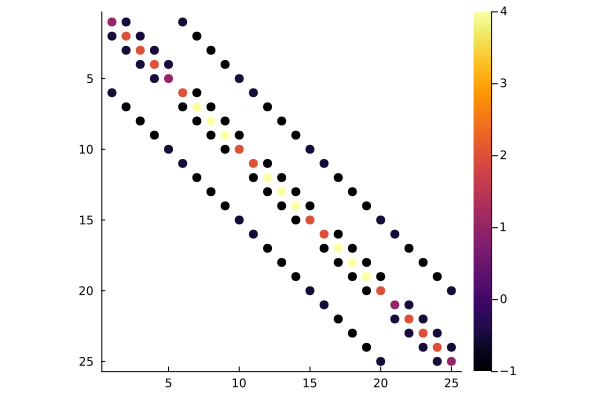

In [19]:
function assembly(VX::Vector{Float64},VY::Vector{Float64},EToV::Matrix{Int64},lam1::Float64,lam2::Float64,qt::Vector{Float64}) :: Tuple{SparseMatrixCSC{Float64,Int64},Vector{Float64}}
    N,_ = size(EToV)
    M = length(VX)
    A = spzeros((M,M))
    b = zeros(M)
    for n in 1:N
        #i,j,k = EToV[n,:]
        delta,abc = basfun(n,VX,VY,EToV)
        delta = abs(delta)
        for r in 1:3
            i = EToV[n,r]
            qn = delta * sum(qt[EToV[n,:]]) / 9
            b[i] += qn
            for s in 1:3
                j = EToV[n,s]
                kn = (lam1*abc[r,2]*abc[s,2]+lam2*abc[r,3]*abc[s,3])/(4*delta)
                A[i,j] += kn
            end
        end
    end
    return A,b
end

VX,VY = xy(0.0,0.0,1.0,1.0,4,4)
EToV = conelmtab(4,4)

lam1 = 1.0
lam2 = 1.0
qt(x,y) = 0.0

A,b = assembly(VX,VY,EToV,lam1,lam2,qt.(VX,VY))
display(A)
display(b)
spy(A,markersize=5)


# Exercise 2.4

##### a)

In [28]:
#=
function dirbc(bnodes::Vector{Int64},f::Vector{Float64},A::Matrix{Float64},b::Vector{Float64}) :: Tuple{Matrix{Float64},Vector{Float64}}
    M = size(A)[1]
    for i in bnodes
        b[i] = f[i]
        A[i,i] = 0
        indeces = findall(A[:,i] .!= 0)
        for idx in indeces
            b[idx] -= A[idx,i] * b[i]
            A[idx,i] = 0
            A[i,idx] = 0
        end
        #b[idx] -= A[idx,i] .* b[i]
        #A[idx,i] = 0
        #A[i,idx] = 0
        A[i,i] = 1
    end
    return A,b
end

f(x,y) = 1.0

bnodes = [1,2,3,4,5,6,10,11,15,16,20,21,22,23,24,25]
Adir,bdir = dirbc(bnodes,f.(VX,VY),A,b)
display(Adir)
display(bdir)
spy(Adir,markersize=5)
=#
function get_bnodes(noelms1::Int64, noelms2::Int64)
    return sort(vcat(
        1:noelms2 + 1,
        1 + noelms1*(noelms2 + 1) : (noelms1 + 1)*(noelms2 + 1),
        noelms2 + 2 : noelms2 + 1 : (noelms1 - 1)*noelms2 + noelms1,
        2*noelms2 + 2 : noelms2 + 1 : noelms1*(noelms2 + 1)
    ))
end

function dirbc(
    bnodes::Vector{Int64}, 
    f::Vector{Float64}, 
    A::SparseMatrixCSC{Float64,Int64}, 
    b::Vector{Float64}
)::Tuple{SparseMatrixCSC{Float64,Int64}, Vector{Float64}}
    A = copy(A)
    b = copy(b)

    for (i, k) in enumerate(bnodes)
        b[k] = f[i]

        A[k, k] = 0
        indices = findall(A[:,k] .!= 0)
        b[indices] -= A[indices, k] .* f[i]

        A[indices, k] .= 0
        A[k, indices] .= 0
        A[k, k] = 1
    end

    return A, b
end


dirbc (generic function with 2 methods)

# Exercise 2.5

##### a)

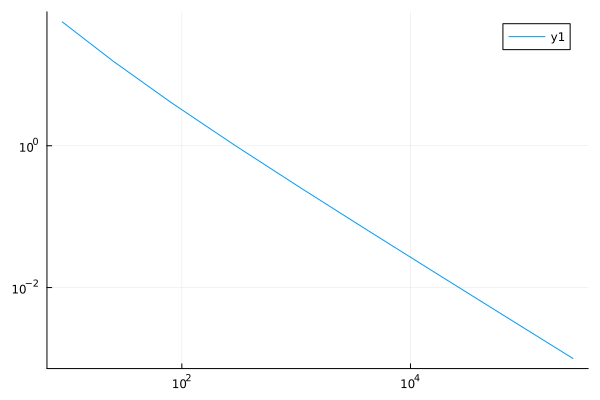

In [30]:
u(x,y) = x^2 * y^2
qt(x,y) = -2*x^2 - 2*y^2

x0 = -2.5
y0 = -4.8
L1 = 7.6
L2 = 5.9
lam1 = 1.0
lam2 = 1.0

max_errors = []
DOF = []
for p in 1:9
    noelms1 = noelms2 = 2^p
    VX, VY = xy(x0, y0, L1, L2, noelms1, noelms2)
    EToV = conelmtab(noelms1, noelms2)

    A, b = assembly(VX, VY, EToV, lam1, lam2, qt.(VX, VY))

    bnodes = get_bnodes(noelms1, noelms2)
    A, b = dirbc(bnodes, u.(VX[bnodes], VY[bnodes]), A, b)

    uhat = A \ b

    push!(max_errors,maximum(abs.(uhat - u.(VX, VY))))
    push!(DOF,length(VX))
end
display(plot(DOF,max_errors,xscale=:log10,yscale=:log10))



# Exercise 2.6

##### a)

In [31]:
function constructBeds(
    VX::Vector{Float64},
    VY::Vector{Float64},
    EToV::Matrix{Int64},
    tol::Float64,
    fd::Function,
)::Matrix{Int64}
    xc = (VX[EToV] + VX[EToV[:, [2, 3, 1]]]) ./ 2
    yc = (VY[EToV] + VY[EToV[:, [2, 3, 1]]]) ./ 2
    return getindex.(findall(abs.(fd.(xc, yc)) .<= tol), [1 2])
end

x0 = -2.5
y0 = -4.8
L1 = 7.6
L2 = 5.9
noelms1 = 4
noelms2 = 3

VX, VY = xy(x0, y0, L1, L2, noelms1, noelms2)
EToV = conelmtab(noelms1, noelms2)

tol = 0.0001
d(x, y) = min(x - x0, y - y0, x0 + L1 - x, y0 + L2 - y)
beds = constructBeds(VX, VY, EToV, tol, d)
display(beds)

14×2 Matrix{Int64}:
 13  1
 14  1
 15  1
 10  2
 11  2
 12  2
 15  2
 18  2
 21  2
 24  2
  1  3
  4  3
  7  3
 10  3

##### b)

In [32]:
function edgeIndices(
    EToV::Matrix{Int64},
    beds::Matrix{Int64},
)::Tuple{Vector{Int64}, Vector{Int64}}
    n = beds[:, 1]
    r = beds[:, 2]
    s = r .% 3 .+ 1

    i = EToV[CartesianIndex.(n, r)]
    j = EToV[CartesianIndex.(n, s)]

    return i,j
end

function neubc(
    VX::Vector{Float64},
    VY::Vector{Float64},
    EToV::Matrix{Int64},
    beds::Matrix{Int64},
    q::Vector{Float64},
    b::Vector{Float64}
)::Vector{Float64}
    i, j = edgeIndices(EToV, beds)
    q1 = q .* sqrt.((VX[j] - VX[i]).^2 + (VY[j] - VY[i]).^2) ./ 2

    b[i] -= q1
    b[j] -= q1

    return b
end

neubc (generic function with 1 method)

# Exercise 2.7

In [33]:
function constructBnodes(
    VX::Vector{Float64},
    VY::Vector{Float64},
    tol::Float64,
    fd::Function,
)::Vector{Int64}
    return findall(abs.(fd.(VX, VY)) .<= tol)
end

constructBnodes (generic function with 1 method)

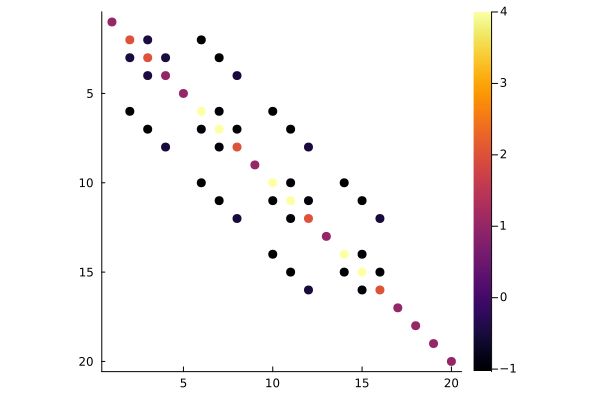

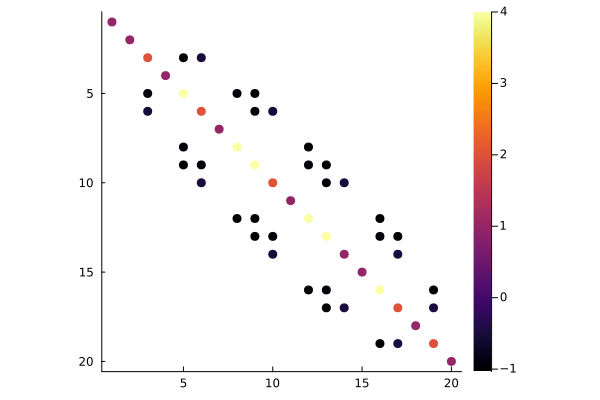

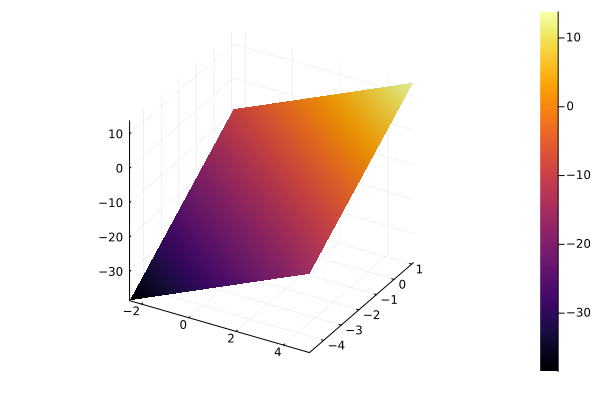

0.0

In [43]:
function solveNDBVP(
    VX::Vector{Float64},
    VY::Vector{Float64},
    EToV::Matrix{Int64},
    lam1::Float64,
    lam2::Float64,
    qt::Function,
    q::Function,
    f::Function,
    fd_gamma1::Function,
    fd_gamma2::Function,
    tol::Float64
)::Vector{Float64}
    A, b = assembly(VX, VY, EToV, lam1, lam2, qt.(VX, VY))
    
    beds = constructBeds(VX, VY, EToV, tol, fd_gamma1)
    i, j = edgeIndices(EToV, beds)
    b = neubc(VX, VY, EToV, beds, q.(VX[i], VY[i], VX[j], VY[j]), b)

    bnodes = constructBnodes(VX, VY, tol, fd_gamma2)
    A, b = dirbc(bnodes, f.(VX[bnodes], VY[bnodes]), A, b)

    p = symrcm(A)
    display(spy(A,markersize=5))
    A = A[p,p]
    display(spy(A,markersize=5))
    b = b[p]

    ip = similar(p)
    ip[p] = 1:length(p)

    up = A\b
    u = up[ip]

    return u
end

x0 = -2.5
y0 = -4.8
L1 = 7.6
L2 = 5.9
noelms1 = 4
noelms2 = 3
lam1 = 1.0
lam2 = 1.0

VX, VY = xy(x0, y0, L1, L2, noelms1, noelms2)
EToV = conelmtab(noelms1, noelms2)

u(x, y) = 3.0*x + 5.0*y - 7
ux(x, y) = 3.0
uy(x, y) = 5.0
uxx(x, y) = 0.0
uyy(x, y) = 0.0

qt(x, y) = - uxx(x, y) - uyy(x, y)
f(x, y) = u(x, y)
function q(x1, y1, x2, y2)
    dx = x2 - x1
    dy = y2 - y1
    norm = sqrt(dx^2 + dy^2)
    n1 = dy / norm
    n2 = -dx / norm

    xc = (x1 + x2) / 2
    yc = (y1 + y2) / 2

    return - lam1 * ux(xc, yc) * n1 - lam2 * uy(xc, yc) * n2
end

fd_gamma1(x, y) = min(x - x0, y - y0)
fd_gamma2(x, y) = min(x0 + L1 - x, y0 + L2 - y)
tol = 0.0001

uhat = solveNDBVP(VX,VY,EToV,lam1,lam2,qt,q,f,fd_gamma1,fd_gamma2,tol)
p = scatter(VX, VY, uhat, st=:surface)
scatter!(VX, VY, u.(VX, VY), st=:surface)
display(p)

E = maximum(uhat - u.(VX, VY))

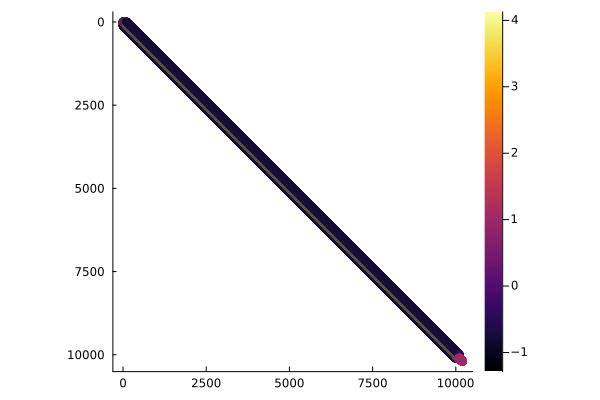

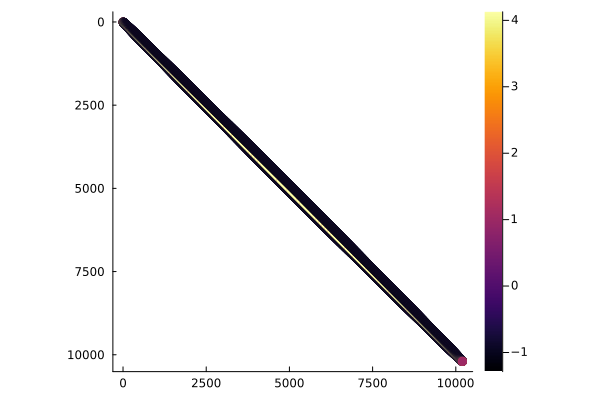

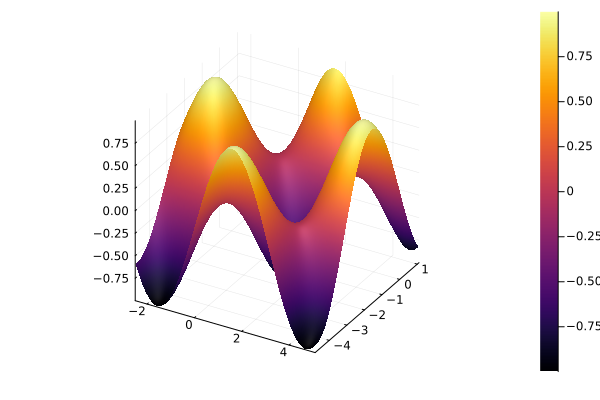

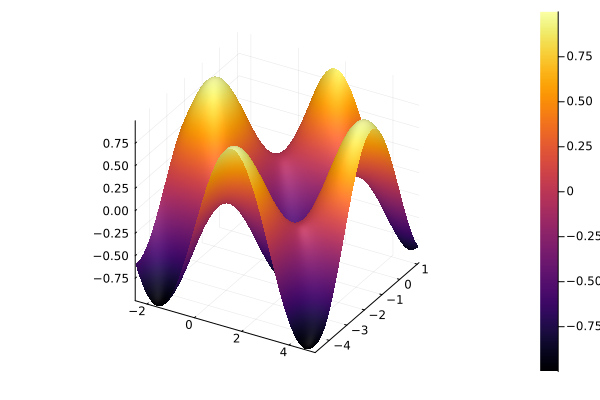

0.0030151111467343616

In [56]:
x0 = -2.5
y0 = -4.8
L1 = 7.6
L2 = 5.9
noelms1 = 100
noelms2 = 100
lam1 = 1.0
lam2 = 1.0

VX, VY = xy(x0, y0, L1, L2, noelms1, noelms2)
EToV = conelmtab(noelms1, noelms2)

u(x, y) = sin(x)*sin(y)
ux(x, y) = cos(x)*sin(y)
uy(x, y) = sin(x)*cos(y)
uxx(x, y) = -sin(x)*sin(y)
uyy(x, y) = -sin(x)*sin(y)

qt(x, y) = - uxx(x, y) - uyy(x, y)
f(x, y) = u(x, y)
function q(x1, y1, x2, y2)
    dx = x2 - x1
    dy = y2 - y1
    norm = sqrt(dx^2 + dy^2)
    n1 = dy / norm
    n2 = -dx / norm

    xc = (x1 + x2) / 2
    yc = (y1 + y2) / 2

    return - lam1 * ux(xc, yc) * n1 - lam2 * uy(xc, yc) * n2
end

fd_gamma1(x, y) = min(x - x0, y - y0)
fd_gamma2(x, y) = min(x0 + L1 - x, y0 + L2 - y)
tol = 0.0001

uhat = solveNDBVP(VX,VY,EToV,lam1,lam2,qt,q,f,fd_gamma1,fd_gamma2,tol)
display(scatter(VX, VY, uhat, st=:surface))
display(scatter(VX, VY, u.(VX, VY), st=:surface))

E = maximum(uhat - u.(VX, VY))